In [223]:
cd S:\Datasets

S:\Datasets


In [224]:
from pathlib import Path
from datetime import datetime
import csv
import pandas as pd
import numpy as np

base_path = Path.cwd().parent / 'Datasets' /  'Solar' / 'daily'
print(base_path)

S:\Datasets\Solar\daily


In [225]:
#Conglomerating multiple files containing multiple excel files into a single input

datsets = ["M1", 
           "M2", 
           "M3",
           "M5",
           "M6",
           "M7",
           "M8",
           "M9",
           "M10",
           "M11",
           "M12",
           "M13",
           "M14",
           "M15", # Missing little top left bit - Corrected
           "M16", # Missing big top and middle chunk - Corrected
           "M17",
           "M18", # Missing little middle chunk - Corrected
          ]

files = []

# for set in base_path.iterdir():
for set in datsets:
    folder = base_path /set
    files = files +list((folder).glob("slope_final.csv"))
    
# This needs to be a join so the columns stack side to side

data_input = pd.concat([pd.read_csv(file, header=0) for file in files])

In [226]:
data_input.head()
#data_input.info()

,Unnamed: 0,Cell,Lat,Long,Model,slope 1,slope 2,slope 3,slope 4,slope 5,...,percent_slope 3,percent_slope 4,percent_slope 5,percent_slope 6,percent_slope 7,percent_slope 8,percent_slope 9,percent_slope 10,percent_slope 11,percent_slope 12
0,0,1,26,-98,1,0.000000,0.000000,0.000000,0.000000,0.000000,...,0,0,0,0,0,0,0,0,0,0
1,1,2,27,-99,1,0.000000,0.000000,0.000000,0.000000,0.000000,...,-2,1,0,0,1,2,2,2,8,6
2,2,3,27,-98,1,0.000000,0.000000,0.000000,0.000000,0.000000,...,-2,2,0,0,0,1,2,2,8,8
3,3,4,26,-81,1,0.000000,0.000000,0.000000,0.000000,0.000000,...,-4,0,0,1,0,3,0,-1,0,-1
4,5,6,28,-99,1,-0.002923,-0.004492,-0.005114,0.002117,0.001069,...,-2,1,0,0,1,2,3,3,11,9


In [227]:
corr_matrix = data_input.corr()

#Print the correlation values for a desired feature
corr_matrix["Lat"].sort_values(ascending=False)

Lat                 1.000000
Unnamed: 0          0.986520
Cell                0.986520
mean 7              0.524131
mean 8              0.330066
mean 6              0.250250
slope 9             0.236156
percent_slope 9     0.216245
slope 7             0.206345
percent_slope 7     0.203900
slope 6             0.119774
percent_slope 6     0.100478
slope 8             0.044089
percent_slope 8     0.033391
Model              -0.003331
slope 10           -0.035917
percent_slope 10   -0.079064
mean 5             -0.082940
slope 5            -0.101416
percent_slope 5    -0.118536
Long               -0.146427
mean 9             -0.185208
percent_slope 1    -0.201974
slope 1            -0.204197
slope 2            -0.227783
percent_slope 2    -0.254196
slope 4            -0.255282
percent_slope 4    -0.261637
slope 3            -0.262676
percent_slope 3    -0.268948
slope 11           -0.324462
percent_slope 11   -0.360827
mean 4             -0.364896
slope 12           -0.487298
percent_slope 

In [228]:
data_input.std()

#print(min(data_input["slope 1"]))
#print(max(data_input["slope 1"]))
data_input["slope 1"].std()

0.005347545040796887

In [229]:
grid = pd.concat([pd.read_csv(base_path/"grid.csv", header=0)])

In [230]:
grid.head()

,Cell,Lat,Long
0,1,26,-98
1,2,27,-99
2,3,27,-98
3,4,26,-81
4,5,26,-80


In [231]:
grid['slope 1'] = 0
grid['slope 2'] = 0
grid['slope 3'] = 0
grid['slope 4'] = 0
grid['slope 5'] = 0
grid['slope 6'] = 0
grid['slope 7'] = 0
grid['slope 8'] = 0
grid['slope 9'] = 0
grid['slope 10'] = 0
grid['slope 11'] = 0
grid['slope 12'] = 0

grid['pval 1'] = 0
grid['pval 2'] = 0
grid['pval 3'] = 0
grid['pval 4'] = 0
grid['pval 5'] = 0
grid['pval 6'] = 0
grid['pval 7'] = 0
grid['pval 8'] = 0
grid['pval 9'] = 0
grid['pval 10'] = 0
grid['pval 11'] = 0
grid['pval 12'] = 0

grid['std 1'] = 0
grid['std 2'] = 0
grid['std 3'] = 0
grid['std 4'] = 0
grid['std 5'] = 0
grid['std 6'] = 0
grid['std 7'] = 0
grid['std 8'] = 0
grid['std 9'] = 0
grid['std 10'] = 0
grid['std 11'] = 0
grid['std 12'] = 0

grid['mean 1'] = 0
grid['mean 2'] = 0
grid['mean 3'] = 0
grid['mean 4'] = 0
grid['mean 5'] = 0
grid['mean 6'] = 0
grid['mean 7'] = 0
grid['mean 8'] = 0
grid['mean 9'] = 0
grid['mean 10'] = 0
grid['mean 11'] = 0
grid['mean 12'] = 0

grid['percent_mean 1'] = 0
grid['percent_mean 2'] = 0
grid['percent_mean 3'] = 0
grid['percent_mean 4'] = 0
grid['percent_mean 5'] = 0
grid['percent_mean 6'] = 0
grid['percent_mean 7'] = 0
grid['percent_mean 8'] = 0
grid['percent_mean 9'] = 0
grid['percent_mean 10'] = 0
grid['percent_mean 11'] = 0
grid['percent_mean 12'] = 0

#gridl = grid

In [232]:
from scipy import stats

for i in range(0,len(grid)):
    
    temp_data_input = data_input[data_input.Cell == i]
    
    pop = 17
    
    poptrt = pop**.5
    
    t = 2.120 # For a population of 17
    
    p = 1 #671.140
    
    na = 9999
    
    px = 0.05
    
    # pop = 16
    # 95% confidence = std / sqrt(pop)
    
    # The standard error
    
    grid['std 1'][i] = (temp_data_input["slope 1"].std()/poptrt)*t
    grid['std 2'][i] = (temp_data_input["slope 2"].std()/poptrt)*t
    grid['std 3'][i] = (temp_data_input["slope 3"].std()/poptrt)*t
    grid['std 4'][i] = (temp_data_input["slope 4"].std()/poptrt)*t
    grid['std 5'][i] = (temp_data_input["slope 5"].std()/poptrt)*t
    grid['std 6'][i] = (temp_data_input["slope 6"].std()/poptrt)*t
    grid['std 7'][i] = (temp_data_input["slope 7"].std()/poptrt)*t
    grid['std 8'][i] = (temp_data_input["slope 8"].std()/poptrt)*t
    grid['std 9'][i] = (temp_data_input["slope 9"].std()/poptrt)*t
    grid['std 10'][i] = (temp_data_input["slope 10"].std()/poptrt)*t
    grid['std 11'][i] = (temp_data_input["slope 11"].std()/poptrt)*t
    grid['std 12'][i] = (temp_data_input["slope 12"].std()/poptrt)*t
    
    
    # determining p values
    
    try:
        grid['pval 1'][i] = stats.normaltest(temp_data_input["slope 1"]).pvalue
                                                            
    except:
        grid['pval 1'][i] = na
        
    try:
        grid['pval 2'][i] = stats.normaltest(temp_data_input["slope 2"]).pvalue
    except:
        grid['pval 2'][i] = na
    
    try:
        grid['pval 3'][i] = stats.normaltest(temp_data_input["slope 3"]).pvalue
    except:
        grid['pval 3'][i] = na
        
    try:
        grid['pval 4'][i] = stats.normaltest(temp_data_input["slope 4"]).pvalue
    except:
        grid['pval 4'][i] = na
        
    try:
        grid['pval 5'][i] = stats.normaltest(temp_data_input["slope 5"]).pvalue
    except:
        grid['pval 5'][i] = na
        
    try:
        grid['pval 6'][i] = stats.normaltest(temp_data_input["slope 6"]).pvalue
    except:
        grid['pval 6'][i] = na
        
    try:
        grid['pval 7'][i] = stats.normaltest(temp_data_input["slope 7"]).pvalue
    except:
        grid['pval 7'][i] = na
        
    try:
        grid['pval 8'][i] = stats.normaltest(temp_data_input["slope 8"]).pvalue
    except:
        grid['pval 8'][i] = na
        
    try:
        grid['pval 9'][i] = stats.normaltest(temp_data_input["slope 9"]).pvalue
    except:
        grid['pval 9'][i] = na
        
    try:
        grid['pval 10'][i] =stats.normaltest(temp_data_input["slope 10"]).pvalue
    except:
        grid['pval 10'][i] = na
    
    try:
        grid['pval 11'][i] =stats.normaltest(temp_data_input["slope 11"]).pvalue
    except:
        grid['pval 11'][i] = na
        
    try:
        grid['pval 12'][i] =stats.normaltest(temp_data_input["slope 12"]).pvalue
    except:
        grid['pval 12'][i] = na
    
    
    # The mean slope
    
    grid['mean 1'][i] = abs(temp_data_input["slope 1"].mean())
    grid['mean 2'][i] = abs(temp_data_input["slope 2"].mean())
    grid['mean 3'][i] = abs(temp_data_input["slope 3"].mean())
    grid['mean 4'][i] = abs(temp_data_input["slope 4"].mean())
    grid['mean 5'][i] = abs(temp_data_input["slope 5"].mean())
    grid['mean 6'][i] = abs(temp_data_input["slope 6"].mean())
    grid['mean 7'][i] = abs(temp_data_input["slope 7"].mean())
    grid['mean 8'][i] = abs(temp_data_input["slope 8"].mean())
    grid['mean 9'][i] = abs(temp_data_input["slope 9"].mean())
    grid['mean 10'][i] = abs(temp_data_input["slope 10"].mean())
    grid['mean 11'][i] = abs(temp_data_input["slope 11"].mean())
    grid['mean 12'][i] = abs(temp_data_input["slope 12"].mean())
    
    grid['percent_mean 1'][i] = temp_data_input["percent_slope 1"].mean()
    grid['percent_mean 2'][i] = temp_data_input["percent_slope 2"].mean()
    grid['percent_mean 3'][i] = temp_data_input["percent_slope 3"].mean()
    grid['percent_mean 4'][i] = temp_data_input["percent_slope 4"].mean()
    grid['percent_mean 5'][i] = temp_data_input["percent_slope 5"].mean()
    grid['percent_mean 6'][i] = temp_data_input["percent_slope 6"].mean()
    grid['percent_mean 7'][i] = temp_data_input["percent_slope 7"].mean()
    grid['percent_mean 8'][i] = temp_data_input["percent_slope 8"].mean()
    grid['percent_mean 9'][i] = temp_data_input["percent_slope 9"].mean()
    grid['percent_mean 10'][i] = temp_data_input["percent_slope 10"].mean()
    grid['percent_mean 11'][i] = temp_data_input["percent_slope 11"].mean()
    grid['percent_mean 12'][i] = temp_data_input["percent_slope 12"].mean()
    
    if((abs(grid['mean 1'][i])) - grid['std 1'][i]) > 0 and grid['pval 1'][i] > px:
        
        grid['slope 1'][i] = grid['percent_mean 1'][i]*p 
    else:
        grid['slope 1'][i] = grid['percent_mean 1'][i]*p #na
        
    if(abs((grid['mean 2'][i])) - grid['std 2'][i]) > 0 and grid['pval 2'][i] > px:
        
        grid['slope 2'][i] = grid['percent_mean 2'][i]*p
    else:
        grid['slope 2'][i] = grid['percent_mean 2'][i]*p#na
        
    if(abs((grid['mean 3'][i])) - grid['std 3'][i]) > 0 and grid['pval 3'][i] > px:
        
        grid['slope 3'][i] = grid['percent_mean 3'][i]*p 
    else:
        grid['slope 3'][i] = grid['percent_mean 3'][i]*p#na
        
    if(abs((grid['mean 4'][i])) - grid['std 4'][i]) > 0 and grid['pval 4'][i] > px:
        
        grid['slope 4'][i] = grid['percent_mean 4'][i]*p 
    else:
        grid['slope 4'][i] = grid['percent_mean 4'][i]*p#na
        
    if(abs((grid['mean 5'][i])) - grid['std 5'][i]) > 0 and grid['pval 5'][i] > px:
        
        grid['slope 5'][i] = grid['percent_mean 5'][i]*p
    else:
        grid['slope 5'][i] = grid['percent_mean 5'][i]*p#na
        
    if(abs((grid['mean 6'][i])) - grid['std 6'][i]) > 0 and grid['pval 6'][i] > px:
        
        grid['slope 6'][i] = grid['percent_mean 6'][i]*p
    else:
        grid['slope 6'][i] = grid['percent_mean 6'][i]*p#na
        
    if(abs((grid['mean 7'][i])) - grid['std 7'][i]) > 0 and grid['pval 7'][i] > px:
        
        grid['slope 7'][i] = grid['percent_mean 7'][i]*p 
    else:
        grid['slope 7'][i] = grid['percent_mean 7'][i]*p#na
        
    if(abs((grid['mean 8'][i])) - grid['std 8'][i]) > 0 and grid['pval 8'][i] > px:
        
        grid['slope 8'][i] = grid['percent_mean 8'][i]*p 
    else:
        grid['slope 8'][i] = grid['percent_mean 8'][i]*p#na
        
    if(abs((grid['mean 9'][i])) - grid['std 9'][i]) > 0 and grid['pval 9'][i] > px:
        
        grid['slope 9'][i] = grid['percent_mean 9'][i]*p 
    else:
        grid['slope 9'][i] = grid['percent_mean 9'][i]*p#na
        
    if(abs((grid['mean 10'][i])) - grid['std 10'][i]) > 0 and grid['pval 10'][i] > px:
        
        grid['slope 10'][i] = grid['percent_mean 10'] [i]*p
    else:
        grid['slope 10'][i] = grid['percent_mean 10'] [i]*p#na
        
    if(abs((grid['mean 11'][i])) - grid['std 11'][i]) > 0 and grid['pval 11'][i] > px:
        
        grid['slope 11'][i] = grid['percent_mean 11'][i]*p 
    else:
        grid['slope 11'][i] = grid['percent_mean 11'][i]*p#na
                    
    if(abs((grid['mean 12'][i])) - grid['std 12'][i]) > 0 and grid['pval 12'][i] > px:
        
        grid['slope 12'][i] = grid['percent_mean 12'][i]*p
    else:
        grid['slope 12'][i] = grid['percent_mean 12'][i]*p#na
            
    
    
    
    

C:\Users\Cody\AppData\Local\Temp\ipykernel_21500\2012991025.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  grid['std 2'][i] = (temp_data_input["slope 2"].std()/poptrt)*t
C:\Users\Cody\anaconda3\envs\Tensorflow_GPU\lib\site-packages\pandas\core\indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
C:\Users\Cody\AppData\Local\Temp\ipykernel_21500\2012991025.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.h

C:\Users\Cody\anaconda3\envs\Tensorflow_GPU\lib\site-packages\scipy\stats\_stats_py.py:1736: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=16
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Users\Cody\anaconda3\envs\Tensorflow_GPU\lib\site-packages\scipy\stats\_stats_py.py:1633: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  b2 = skew(a, axis)
C:\Users\Cody\anaconda3\envs\Tensorflow_GPU\lib\site-packages\scipy\stats\_stats_py.py:1736: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=15
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\Users\Cody\anaconda3\envs\Tensorflow_GPU\lib\site-packages\scipy\stats\_stats_py.py:1736: UserWarning: kurtosistest only valid for n>=20 ... continuing anyway, n=14
  warnings.warn("kurtosistest only valid for n>=20 ... continuing "
C:\User

In [233]:
import rasterio
import geopandas as gp
from shapely.geometry import Point, Polygon

In [234]:
#Create a geodataframe for handling location data to be mapped
geo_metrics = gp.GeoDataFrame()

In [235]:
geo_metrics['geometry'] = None

In [236]:
for i in range(0, len(grid)):
# And create point data from our lat / long pairs in metrics    
    try:
        geo_metrics.loc[i, 'geometry'] = Point(grid['Long'][i], grid['Lat'][i])
        
    except:
        
        pass

In [237]:
# We'll just copy over the other metrics values as well
geo_metrics['slope 1'] = grid['slope 1']
geo_metrics['slope 2'] = grid['slope 2']
geo_metrics['slope 3'] = grid['slope 3']
geo_metrics['slope 4'] = grid['slope 4']
geo_metrics['slope 5'] = grid['slope 5']
geo_metrics['slope 6'] = grid['slope 6']
geo_metrics['slope 7'] = grid['slope 7']
geo_metrics['slope 8'] = grid['slope 8']
geo_metrics['slope 9'] = grid['slope 9']
geo_metrics['slope 10'] = grid['slope 10']
geo_metrics['slope 11'] = grid['slope 11']
geo_metrics['slope 12'] = grid['slope 12']

geo_metrics['Cell'] = grid['Cell']

In [238]:
from fiona.crs import from_epsg
# Set the coordinate reference system to global GPS
geo_metrics.crs = from_epsg(4326)
# and export to a shapefile
geo_metrics.to_file(base_path /'geo_metrics_CONUS.shp')

C:\Users\Cody\anaconda3\envs\Tensorflow_GPU\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [239]:
# We'll just go ahead and import the file we just saved for immediate use
sites = gp.read_file(base_path / 'geo_metrics_CONUS.shp')

In [240]:
# We import a basemap I made in Arc Pro that covers the extent of the dataset

basemap = rasterio.open(base_path /'Layout2.tif')

band_1 = basemap.read(4)
band_2 = basemap.read(3)
band_3 = basemap.read(2)
band_4 = basemap.read(1)

map_stack = np.dstack((band_4, band_3, band_2, band_1))

In [241]:
# and set the extent so it can be graphed alongside our shapefile

extent = [-14040349.345523778, -7444312.377578014, 2049207.2904239604, 7146144.947472963]

# Also cast the shapefile into a compatible CRS
sites = sites.to_crs(from_epsg(3857))
#basemap.crs

C:\Users\Cody\anaconda3\envs\Tensorflow_GPU\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


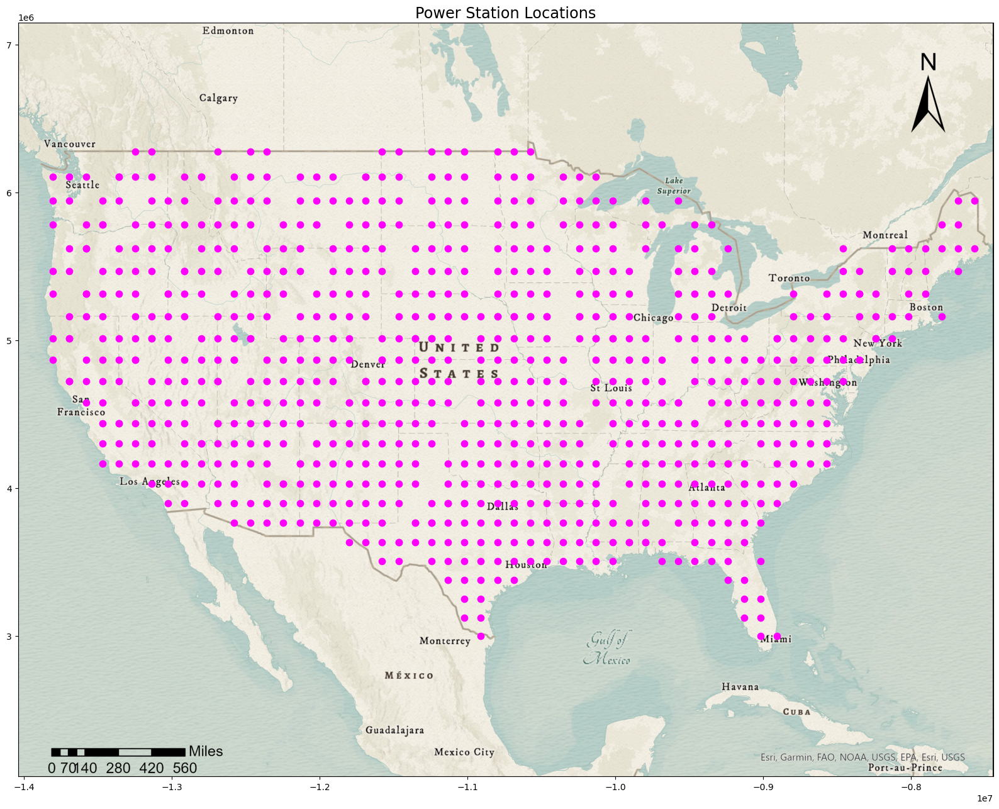

In [242]:
# Let's plot the data, nothing fancy, just pink dots at all the site locations
%matplotlib inline
import matplotlib.pyplot as plt
from rasterio import plot as rasterplot

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

plt.title('Power Station Locations', fontsize = 'xx-large')

sites.plot(ax = ax, color = 'fuchsia', legend = True, markersize = 55)

plt.savefig(base_path / 'locations.pdf')

plt.show()

In [243]:
#print(max(grid['slope 1'], grid['slope 2']))

grid = grid.dropna()

grid['max'] = (grid[['slope 1', 'slope 2', 'slope 3', 'slope 4', 'slope 5', 'slope 6', 'slope 7', 'slope 8', 'slope 9', 'slope 10', 'slope 11', 'slope 12']].values.max(1))
grid['min'] = (grid[['slope 1', 'slope 2', 'slope 3', 'slope 4', 'slope 5', 'slope 6', 'slope 7', 'slope 8', 'slope 9', 'slope 10', 'slope 11', 'slope 12']].values.min(1))

gridmax = max(grid['max'])
gridmin = min(grid['min'])

miniv = -10
maxiv = 10

print(gridmax)
print(gridmin)



colormap = "coolwarm"


4.235294117647059
-19.333333333333332


In [244]:
grid.head()
#temp_grid.head()

,Cell,Lat,Long,slope 1,slope 2,slope 3,slope 4,slope 5,slope 6,slope 7,...,percent_mean 5,percent_mean 6,percent_mean 7,percent_mean 8,percent_mean 9,percent_mean 10,percent_mean 11,percent_mean 12,max,min
6,7,28,-98,1.647059,1.352941,0.470588,0.235294,-0.176471,0.294118,-0.764706,...,-0.176471,0.294118,-0.764706,0.117647,-0.411765,0.529412,3.058824,4.235294,4.235294,-0.764706
7,8,27,-82,1.941176,1.764706,0.411765,0.588235,0.058824,0.470588,-0.941176,...,0.058824,0.470588,-0.941176,-0.117647,-0.705882,0.352941,3.411765,4.176471,4.176471,-0.941176
8,9,27,-81,1.647059,0.588235,-0.294118,-0.647059,-0.529412,0.117647,0.647059,...,-0.529412,0.117647,0.647059,1.117647,0.000000,-1.470588,-0.764706,0.058824,1.647059,-1.470588
9,10,29,-100,1.176471,0.411765,-0.411765,-0.941176,-0.705882,0.117647,0.176471,...,-0.705882,0.117647,0.176471,1.117647,0.294118,-1.235294,-0.882353,-0.235294,1.176471,-1.235294
10,11,29,-99,1.176471,1.058824,0.235294,0.352941,-0.176471,0.058824,-1.411765,...,-0.176471,0.058824,-1.411765,-0.352941,-0.882353,0.411765,2.352941,3.764706,3.764706,-1.411765


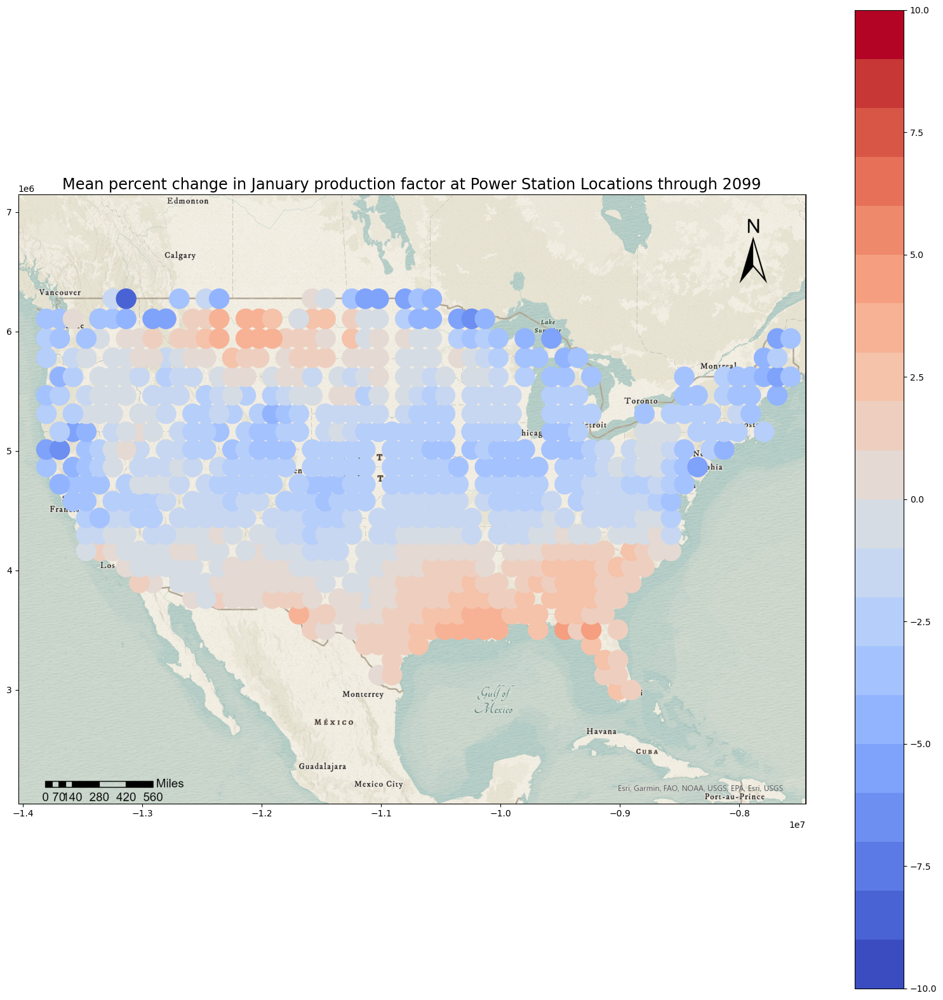

In [245]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

cmap.set_over('w')

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 1', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Mean percent change in January production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'Xfinal_slope_Jan.pdf')
plt.savefig(base_path / 'X1.png')

plt.show()

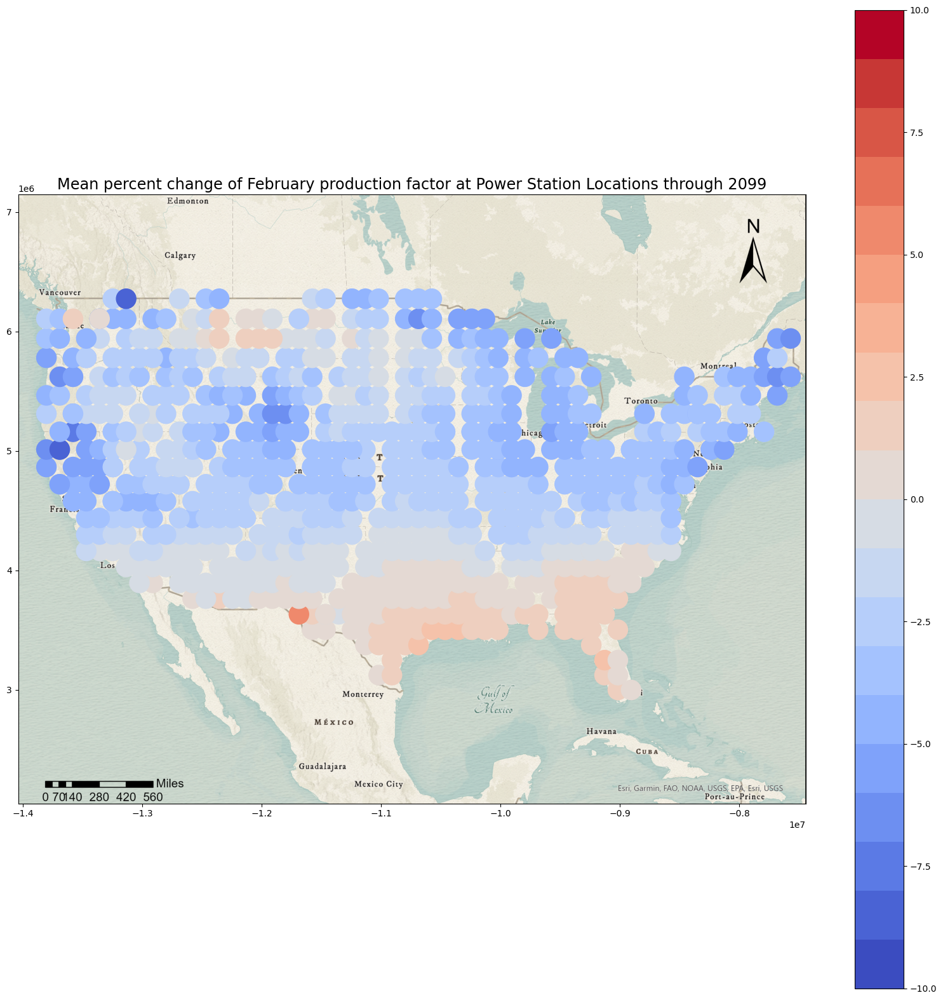

In [246]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

cmap.set_over('w')

fig, ax = plt.subplots(figsize = (20,20))


rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 2', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Mean percent change of February production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'Xfinal_slope_Feb.pdf')
plt.savefig(base_path / 'X2.png')

plt.show()



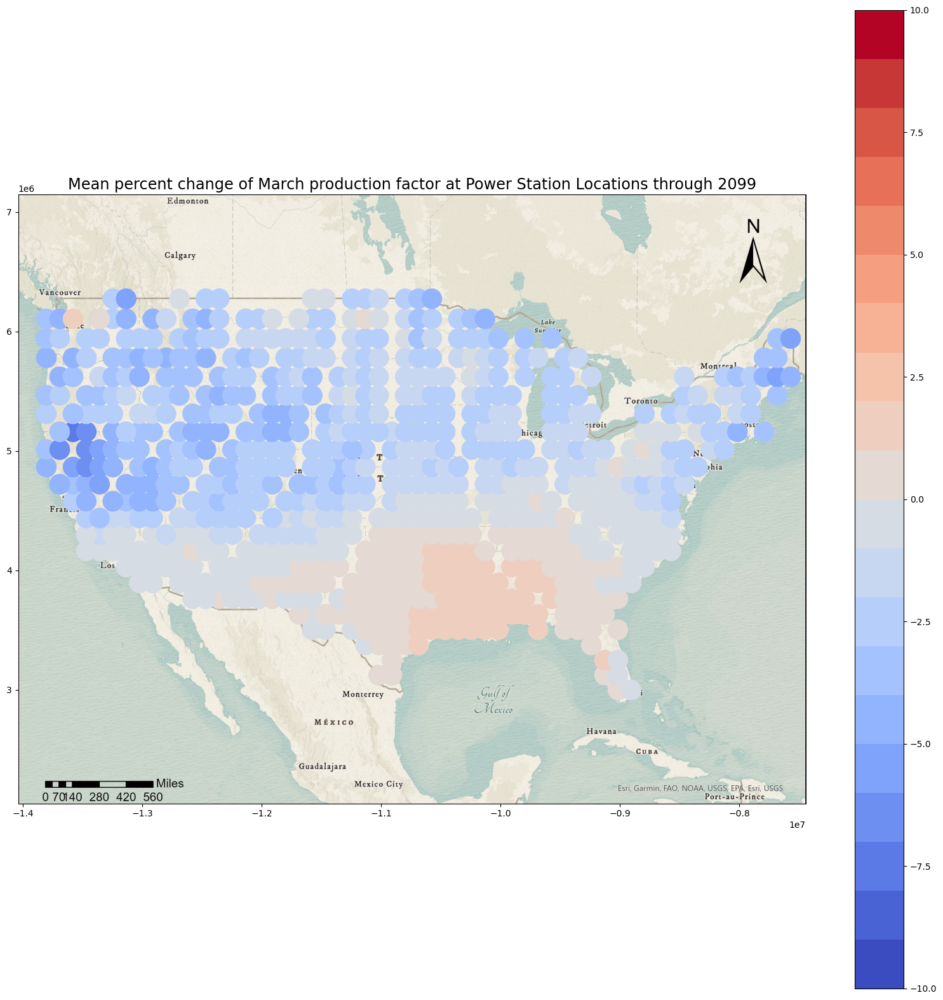

In [247]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

cmap.set_over('w')

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 3', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Mean percent change of March production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'Xfinal_slope_march.pdf')
plt.savefig(base_path / 'X3.png')

plt.show()



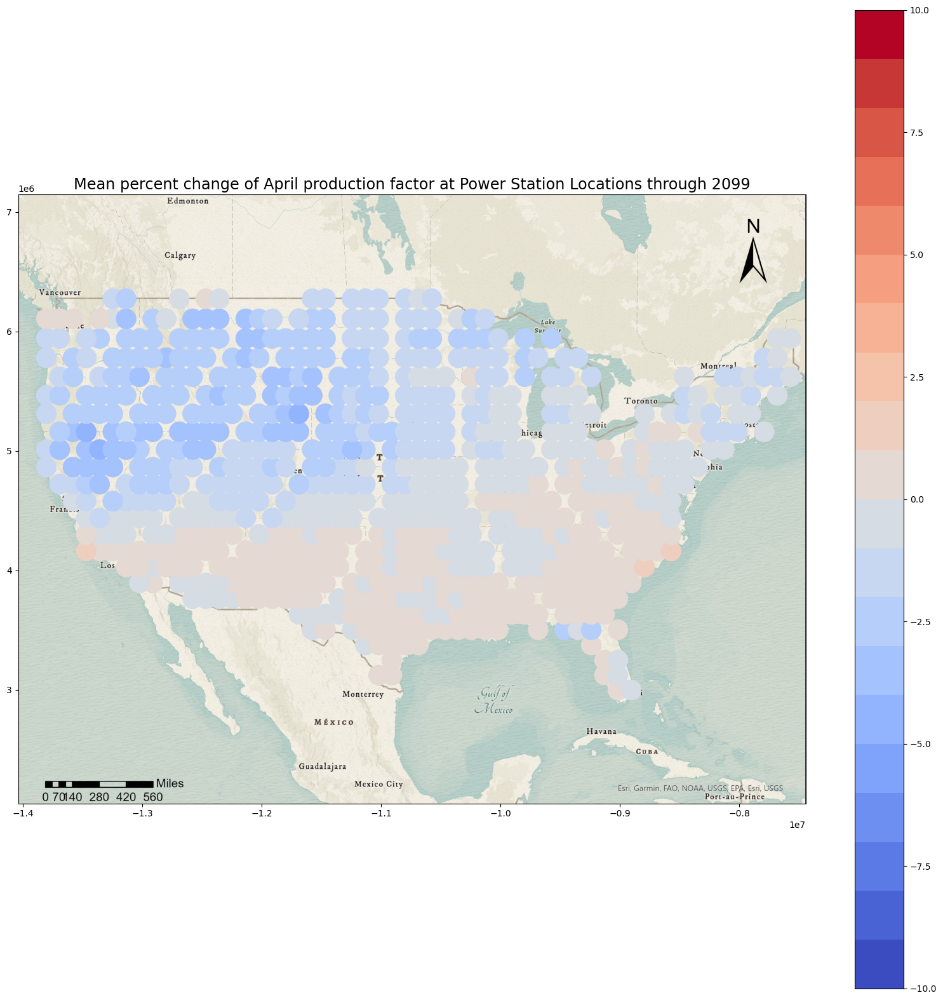

In [248]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

cmap.set_over('w')

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 4', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Mean percent change of April production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'Xfinal_slope_April.pdf')
plt.savefig(base_path / 'X4.png')

plt.show()



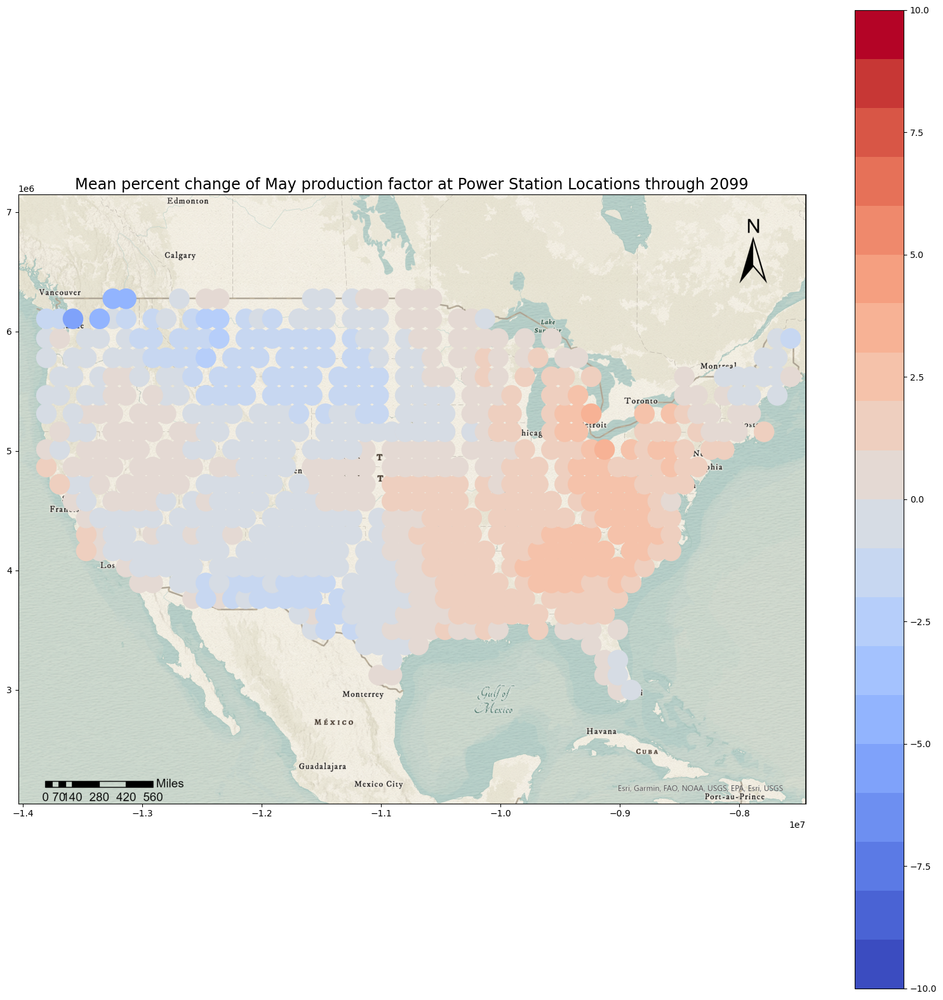

In [249]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

cmap.set_over('w')

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 5', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Mean percent change of May production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'Xfinal_slope_May.pdf')
plt.savefig(base_path / 'X5.png')

plt.show()



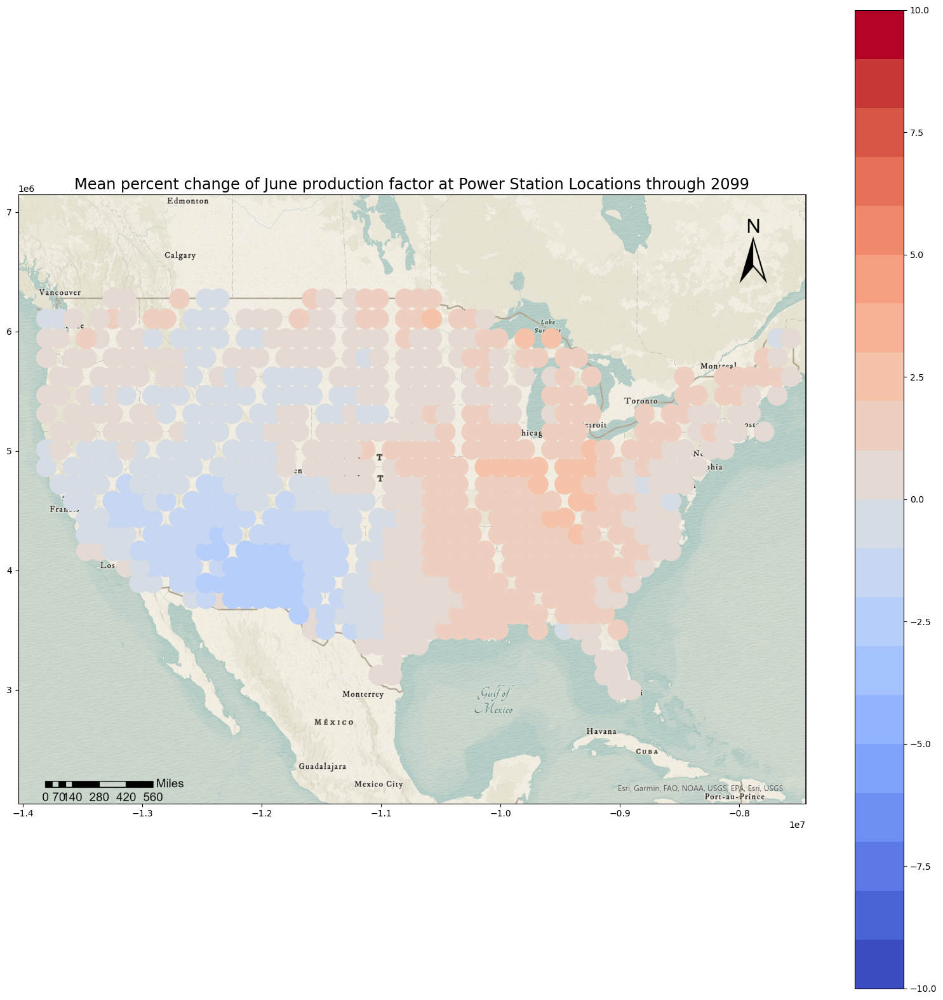

In [250]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

cmap.set_over('w')

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 6', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Mean percent change of June production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'Xfinal_slope_June.pdf')
plt.savefig(base_path / 'X6.png')

plt.show()



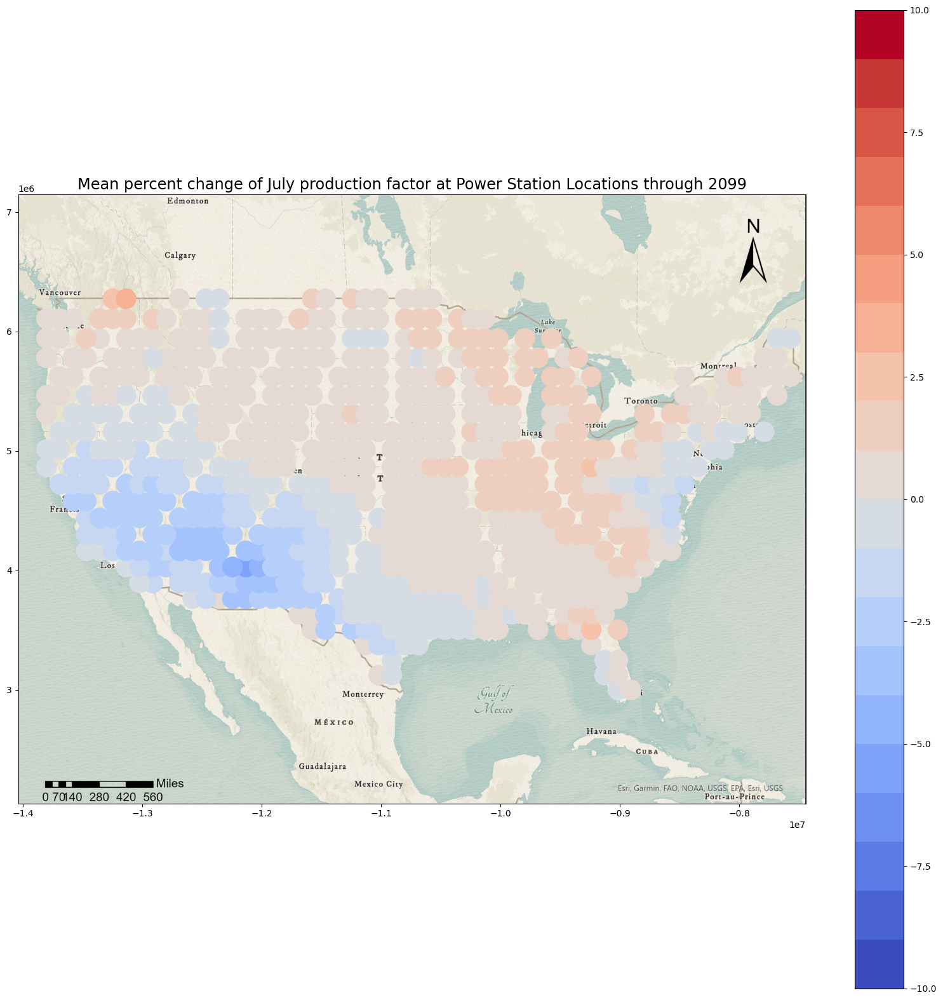

In [251]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

cmap.set_over('w')

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 7', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Mean percent change of July production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'Xfinal_slope_July.pdf')
plt.savefig(base_path / 'X7.png')

plt.show()



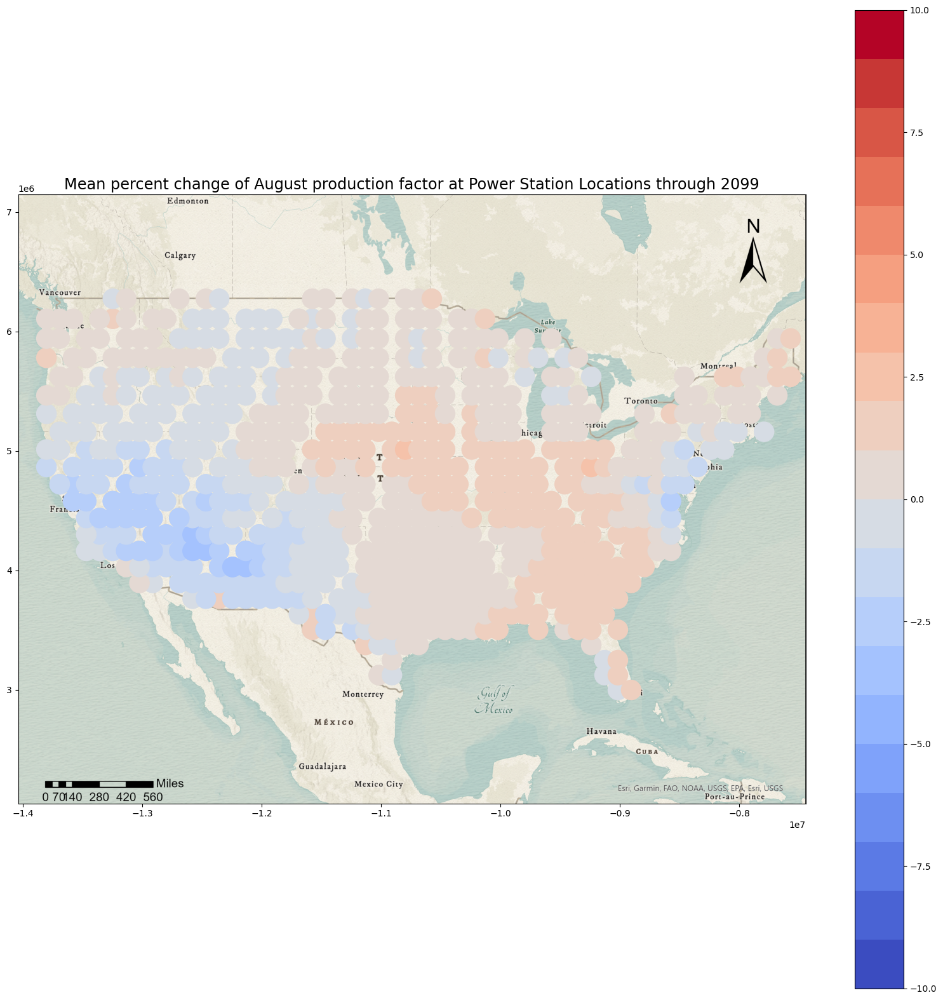

In [252]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

cmap.set_over('w')

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 8', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Mean percent change of August production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'Xfinal_slope_Aug.pdf')
plt.savefig(base_path / 'X8.png')

plt.show()



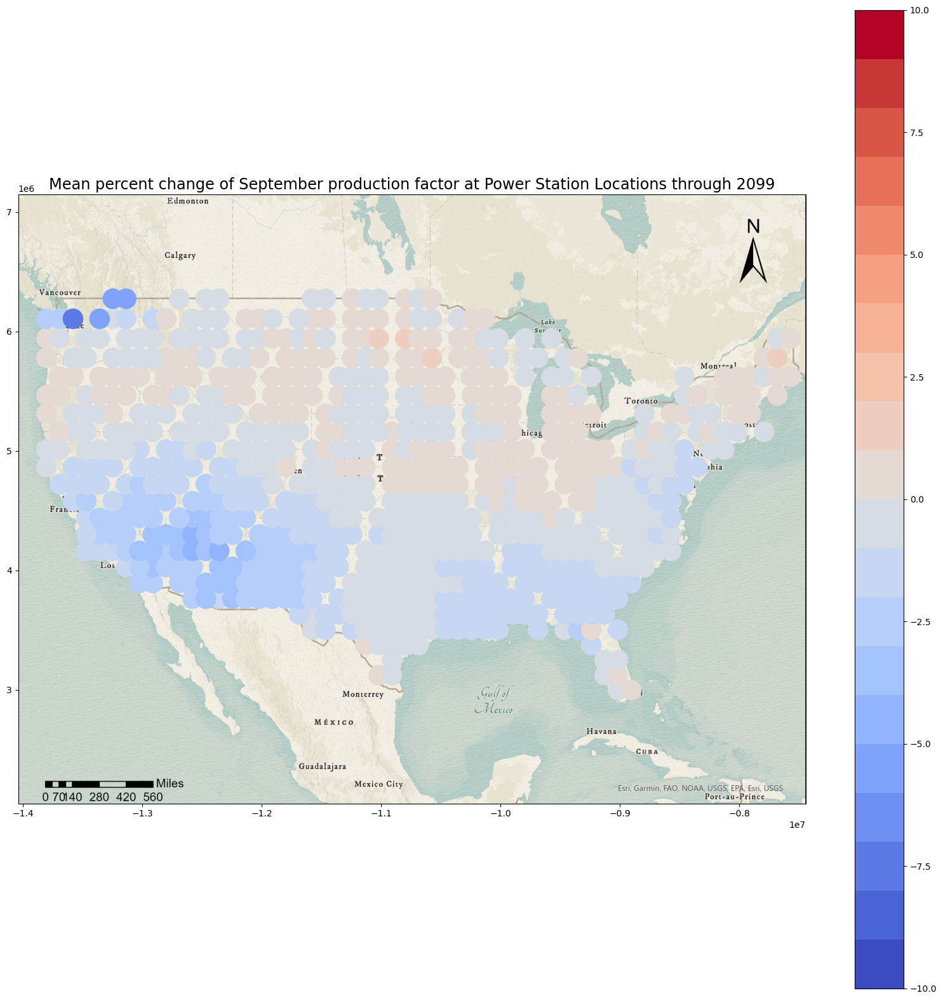

In [253]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

cmap.set_over('w')

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 9', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Mean percent change of September production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'Xfinal_slope_Sept.pdf')
plt.savefig(base_path / 'X9.png')

plt.show()



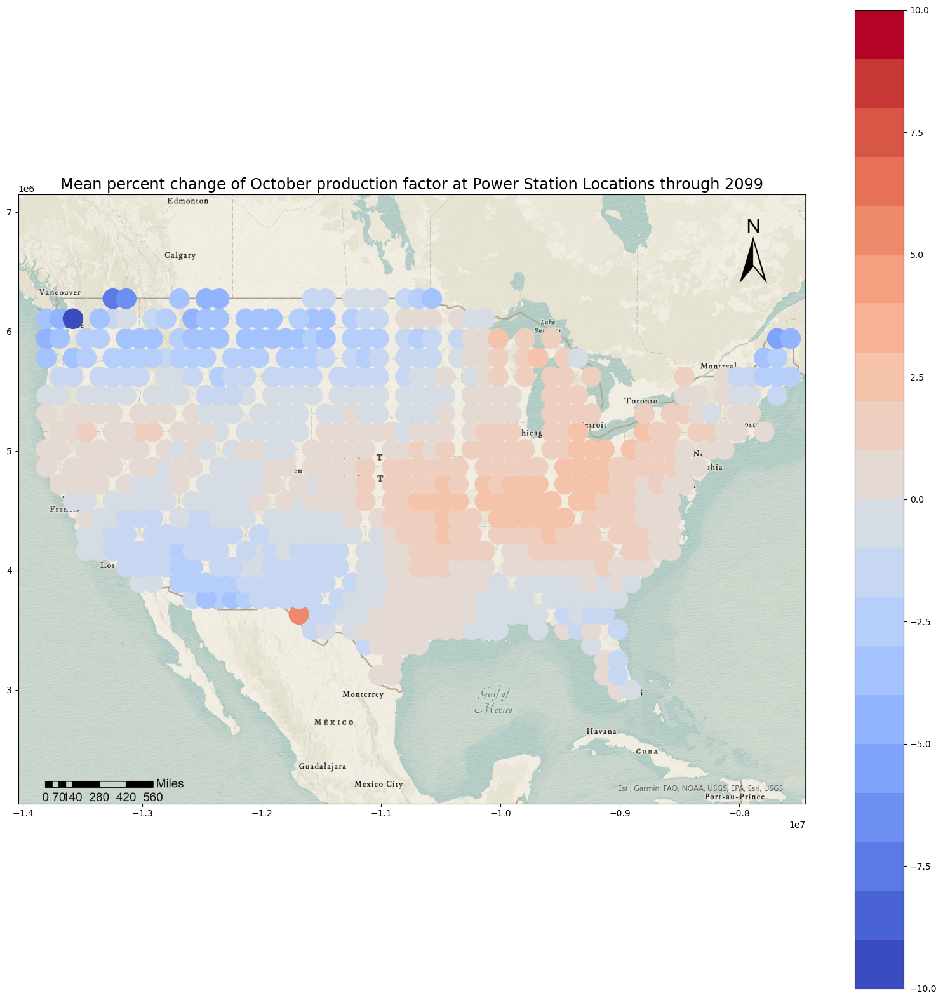

In [254]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

cmap.set_over('w')

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 10', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Mean percent change of October production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'Xfinal_slope_Oct.pdf')
plt.savefig(base_path / 'X10.png')

plt.show()



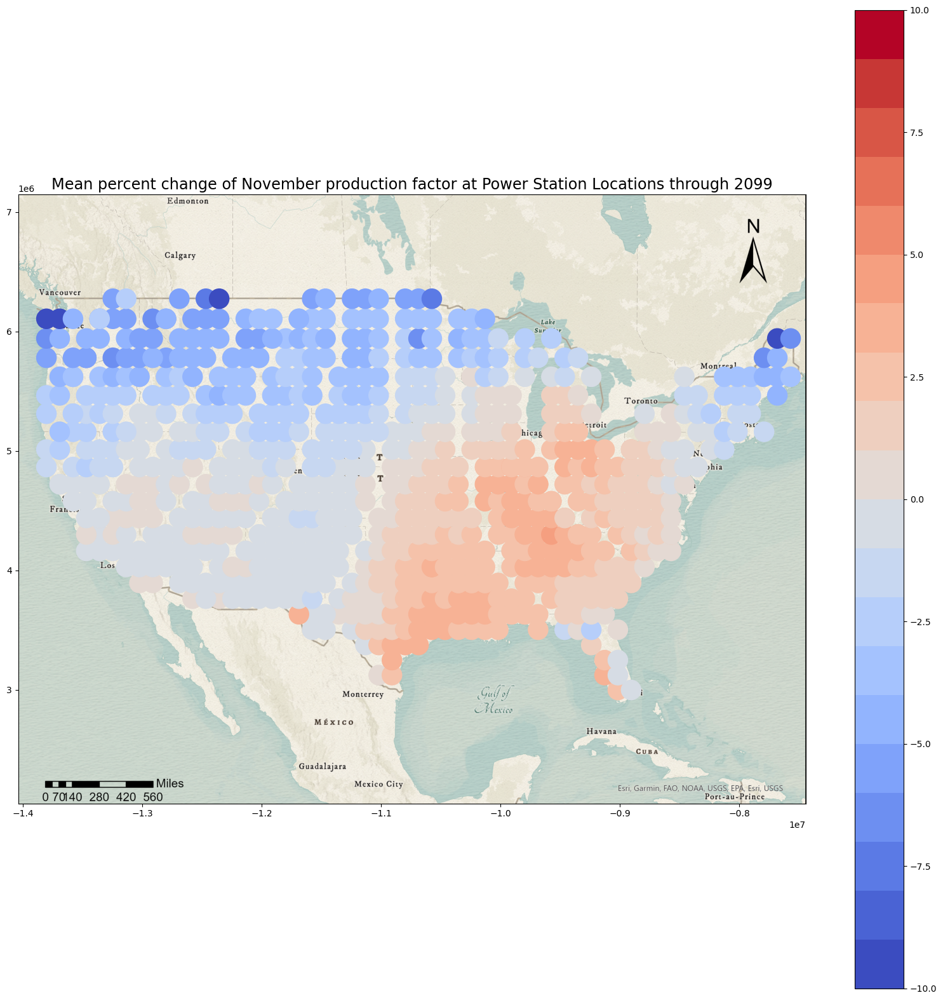

In [255]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

cmap.set_over('w')

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 11', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Mean percent change of November production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'Xfinal_slope_Nov.pdf')
plt.savefig(base_path / 'X11.png')

plt.show()



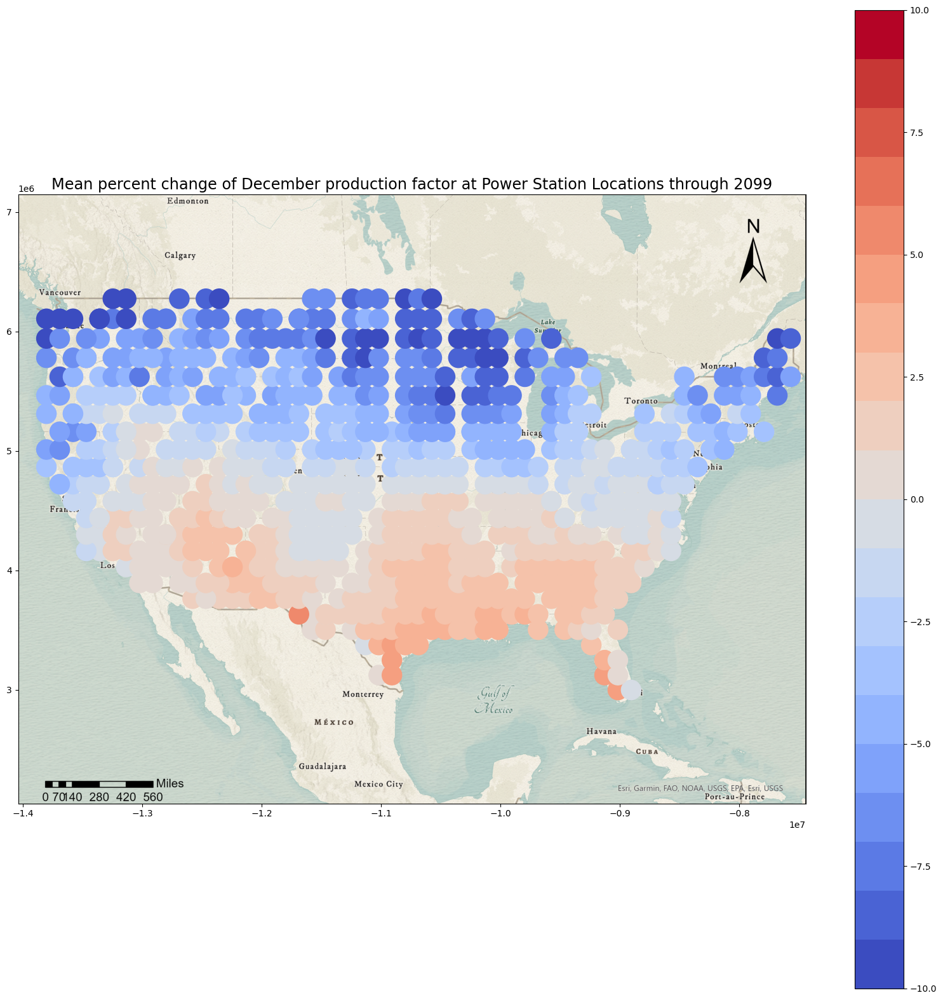

In [256]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

cmap.set_over('w')

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 12', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Mean percent change of December production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'Xfinal_slope_Dec.pdf')
plt.savefig(base_path / 'X12.png')

plt.show()

